In [1]:
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
import os
import PIL.Image
import cv2
import random
from PIL import Image

In [2]:
tf.__version__

'2.4.1'

In [3]:
base_model = tf.keras.applications.InceptionV3(include_top= False, weights = 'imagenet')

In [4]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
_______________________________________________________________________________________

In [5]:
img_1 = Image.open('mars.jpg')
img_2 = Image.open('eiffel.jpg')

image = Image.blend(img_1, img_2, 0.5)

image.save("img_0.jpg")

In [6]:
sample_image = tf.keras.preprocessing.image.load_img('img_0.jpg')

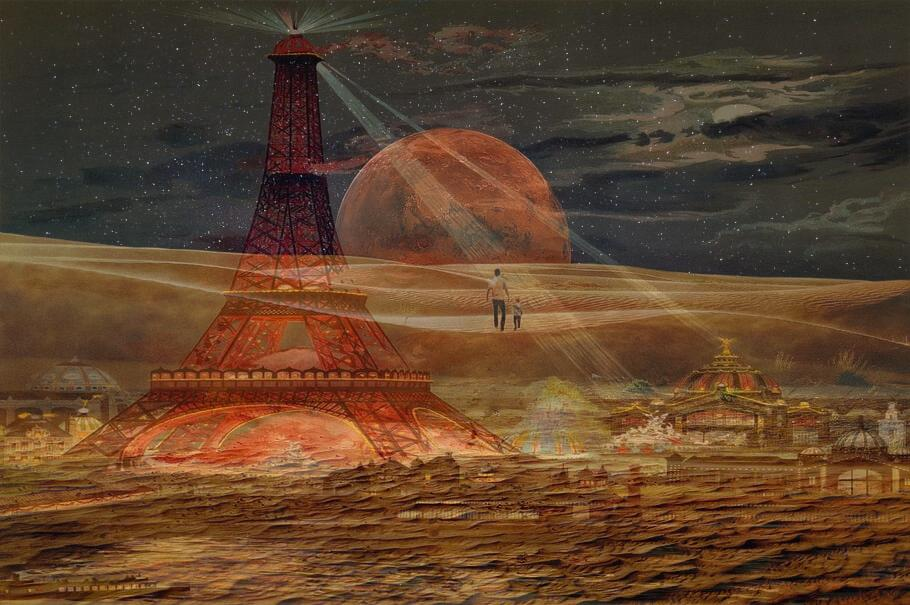

In [7]:
sample_image

In [8]:
np.shape(sample_image)

(605, 910, 3)

In [9]:
type(sample_image)

PIL.JpegImagePlugin.JpegImageFile

In [10]:
sample_image = tf.keras.preprocessing.image.img_to_array(sample_image)

In [11]:
type(sample_image)

numpy.ndarray

In [12]:
print('min pixel values = {}, max pixel value = {}'.format(sample_image.min(), sample_image.max()))

min pixel values = 0.0, max pixel value = 255.0


In [13]:
sample_image = np.array(sample_image)/255.0
sample_image.shape

(605, 910, 3)

In [14]:
print('min pixel values = {}, max pixel value = {}'.format(sample_image.min(), sample_image.max()))

min pixel values = 0.0, max pixel value = 1.0


In [15]:
sample_image = tf.expand_dims(sample_image, axis=0)

In [16]:
np.shape(sample_image)

TensorShape([1, 605, 910, 3])

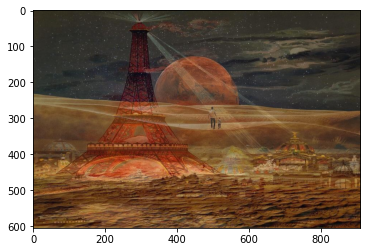

In [17]:
plt.imshow(np.squeeze(sample_image))

In [18]:
np.squeeze(sample_image).shape

(605, 910, 3)

In [19]:
names = ['mixed3', 'mixed5', 'mixed7']
layers = [base_model.get_layer(name).output for name in names]

deepdream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

In [20]:
deepdream_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [21]:
activations = deepdream_model(sample_image)
activations

[<tf.Tensor: shape=(1, 36, 55, 768), dtype=float32, numpy=
 array([[[[0.        , 0.        , 0.        , ..., 0.        ,
           0.2881323 , 0.30937472],
          [0.        , 0.33028132, 0.        , ..., 0.        ,
           0.        , 0.        ],
          [0.        , 0.1616587 , 0.        , ..., 0.        ,
           0.        , 0.        ],
          ...,
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.        ],
          [0.        , 0.        , 0.        , ..., 0.37069905,
           0.        , 0.        ],
          [0.03586823, 0.        , 0.        , ..., 0.37069905,
           0.6461062 , 0.        ]],
 
         [[0.7529484 , 0.        , 0.        , ..., 0.        ,
           0.16688865, 0.70204175],
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.30318806],
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.        ],
          ...,
        

In [22]:
len(activations)

3

In [23]:
x = tf.constant(2.0)

In [24]:
with tf.GradientTape() as g:
    g.watch(x)
    y = x * x * x
dy_dx = g.gradient(y, x)

In [25]:
dy_dx

<tf.Tensor: shape=(), dtype=float32, numpy=12.0>

In [26]:
sample_image.shape

TensorShape([1, 605, 910, 3])

In [27]:
sample_image = tf.squeeze(sample_image, axis = 0)

In [28]:
sample_image.shape

TensorShape([605, 910, 3])

In [29]:
def calc_loss(image, model):
    img_batch = tf.expand_dims(image, axis=0)
    layer_activations = model(img_batch)
    print('Activation Values (Layer Output) =\n', layer_activations)
    print("Activation shape =\n", np.shape(layer_activations))
    
    losses = []
    for act in layer_activations:
        loss = tf.math.reduce_mean(act)
        losses.append(loss)
        
    print("Losses (From Multiple Activation Layers) =\n", losses)
    print("Losses Shape (From Multiple Activation Layers) =\n", np.shape(losses))
    print("Sum of all Losses (From All Selected Layers) =", tf.reduce_sum(losses))
    return tf.reduce_sum(losses)

In [30]:
loss = calc_loss(tf.Variable(sample_image), deepdream_model)

Activation Values (Layer Output) =
 [<tf.Tensor: shape=(1, 36, 55, 768), dtype=float32, numpy=
array([[[[0.        , 0.        , 0.        , ..., 0.        ,
          0.2881323 , 0.30937472],
         [0.        , 0.33028132, 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.1616587 , 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.37069905,
          0.        , 0.        ],
         [0.03586823, 0.        , 0.        , ..., 0.37069905,
          0.6461062 , 0.        ]],

        [[0.7529484 , 0.        , 0.        , ..., 0.        ,
          0.16688865, 0.70204175],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.30318806],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
       

In [31]:
loss

<tf.Tensor: shape=(), dtype=float32, numpy=0.55780554>

In [32]:
@tf.function
def deepdream(model, image, step_size):
    with tf.GradientTape() as tape:
        tape.watch(image)
        loss = calc_loss(image, model)
        
    gradients = tape.gradient(loss, image)
    print('Gradients = \n', gradients)
    print('Gradients shape = \n', np.shape(gradients))
        
    gradients /= tf.math.reduce_std(gradients)
        
    image = image + gradients * step_size
    image = tf.clip_by_value(image, -1, 1)
        
    return loss, image

In [33]:
def run_deep_dream_simple(model, image, steps = 100, step_size = 0.01):
    image = tf.keras.applications.inception_v3.preprocess_input(image)
    for step in range(steps):
        loss, image = deepdream(model, image, step_size)
        
        if step % 100 == 0:
            plt.figure(figsize=(12,12))
            plt.imshow(deprocess(image))
            plt.show()
            print('step {}, loss{}'.format(step, loss))
    
    plt.figure(figsize=(12,12))
    plt.imshow(deprocess(image))
    plt.show()            
    return deprocess(image)
        

In [34]:
def deprocess(image):
    image = 255*(image + 1.0)/2.0
    return tf.cast(image, tf.uint8)

In [35]:
sample_image.shape

TensorShape([605, 910, 3])

Activation Values (Layer Output) =
 [<tf.Tensor 'model/mixed3/concat:0' shape=(1, 36, 55, 768) dtype=float32>, <tf.Tensor 'model/mixed5/concat:0' shape=(1, 36, 55, 768) dtype=float32>, <tf.Tensor 'model/mixed7/concat:0' shape=(1, 36, 55, 768) dtype=float32>]
Activation shape =
 (3,)
Losses (From Multiple Activation Layers) =
 [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>]
Losses Shape (From Multiple Activation Layers) =
 (3,)
Sum of all Losses (From All Selected Layers) = Tensor("Sum:0", shape=(), dtype=float32)
Gradients = 
 Tensor("gradient_tape/Reshape_4:0", shape=(605, 910, 3), dtype=float32)
Gradients shape = 
 (605, 910, 3)


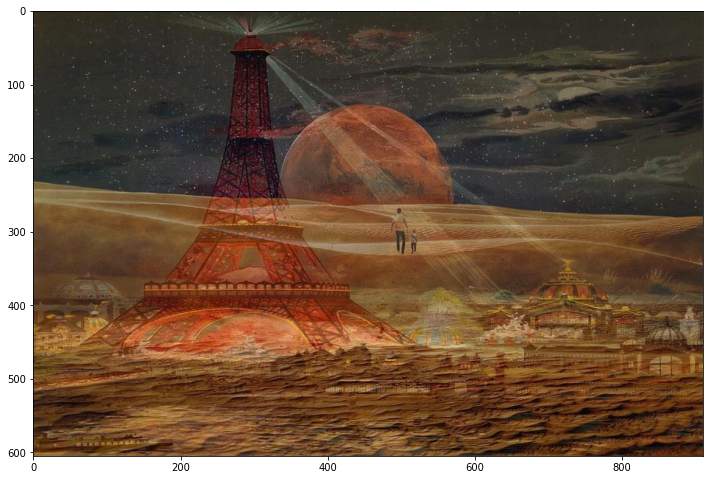

step 0, loss0.5809010863304138


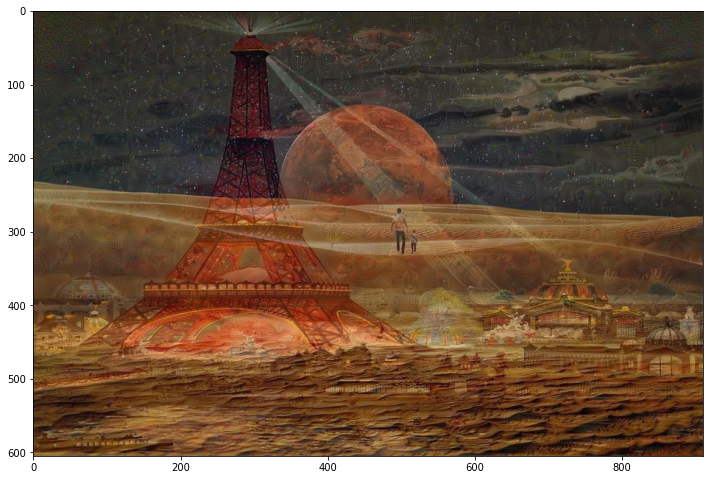

step 100, loss1.2852758169174194


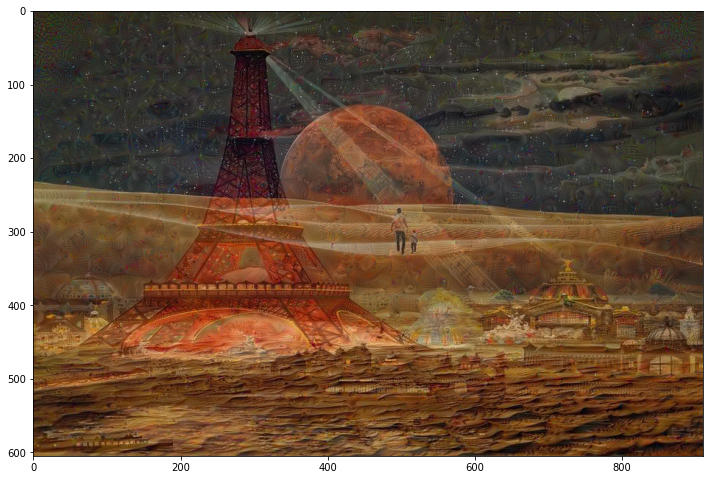

step 200, loss1.5072171688079834


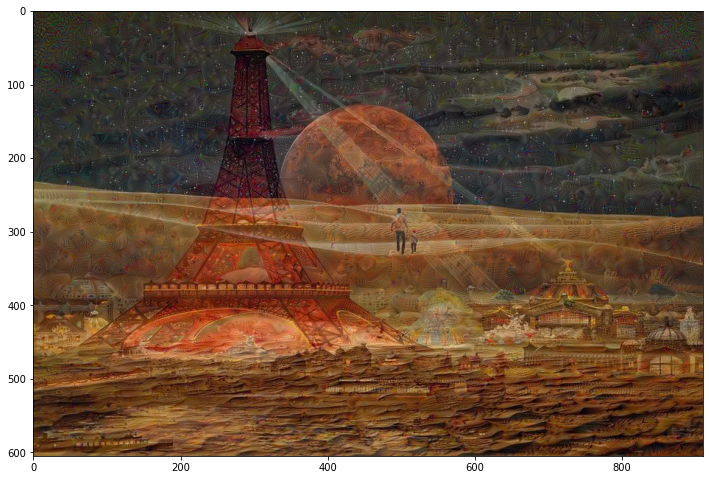

step 300, loss1.6438497304916382


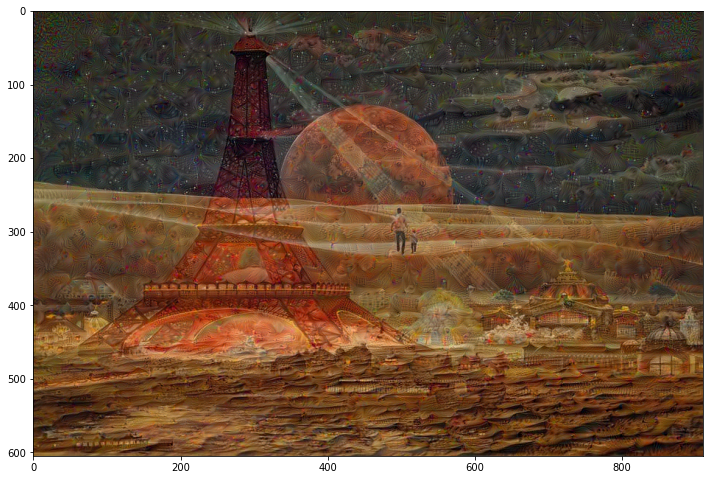

step 400, loss1.7450355291366577


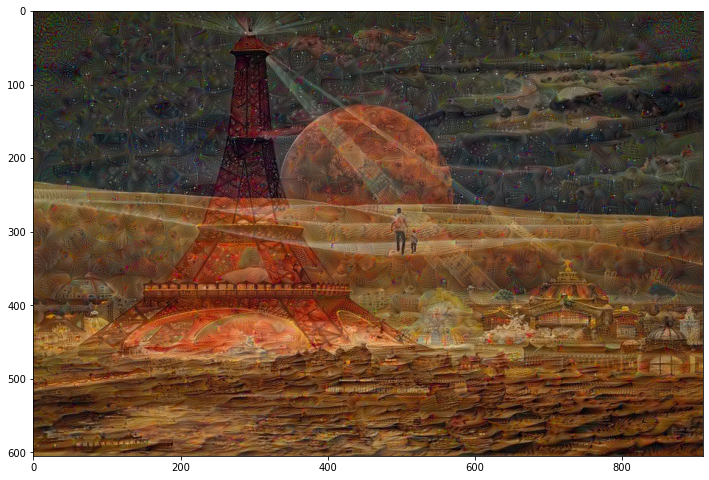

step 500, loss1.8270883560180664


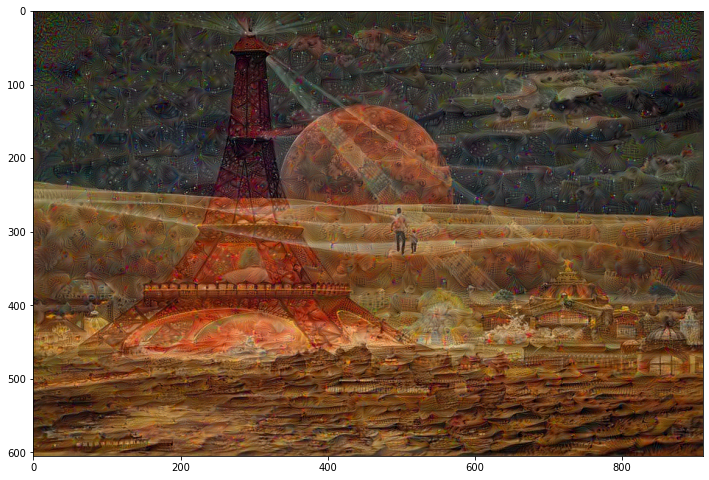

step 600, loss1.8966752290725708


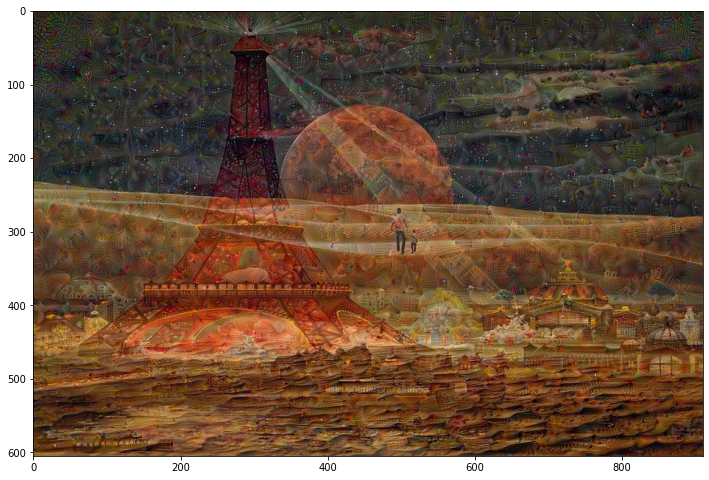

step 700, loss1.9559054374694824


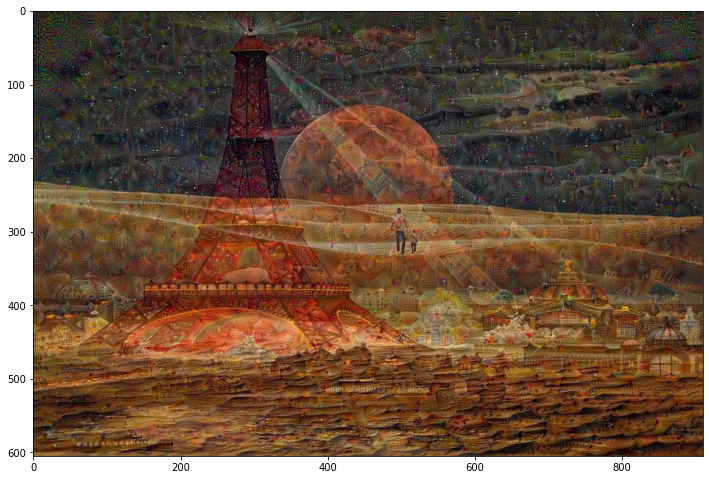

step 800, loss2.009232521057129


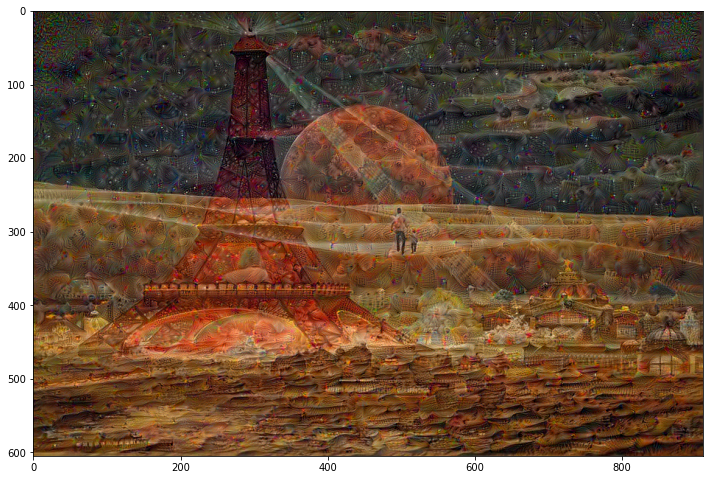

step 900, loss2.057313919067383


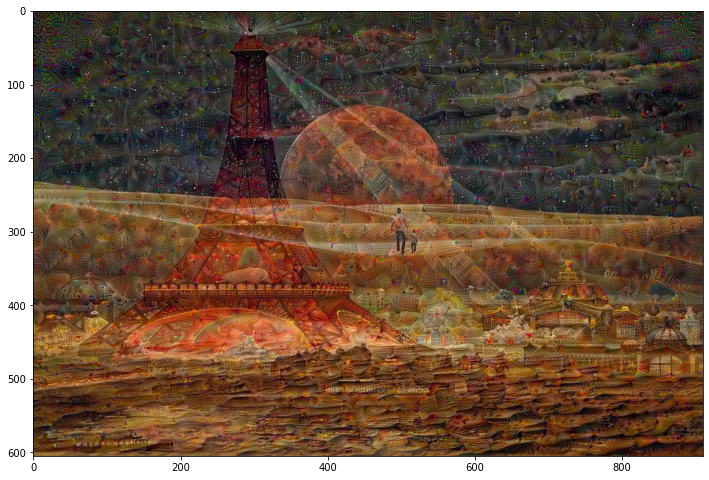

step 1000, loss2.1014957427978516


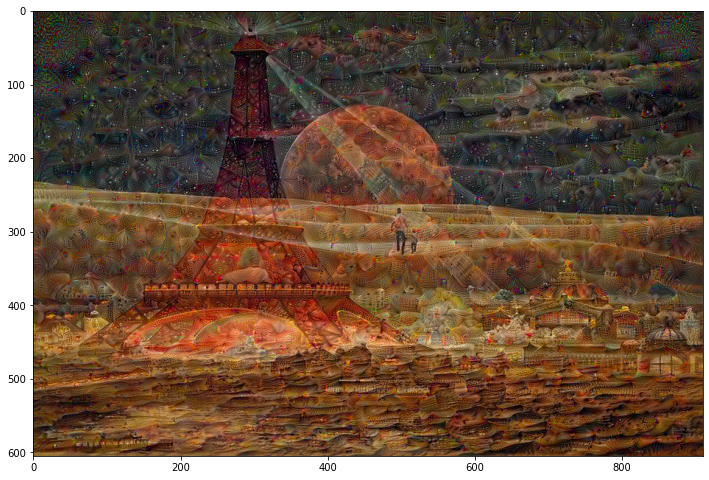

step 1100, loss2.1426501274108887


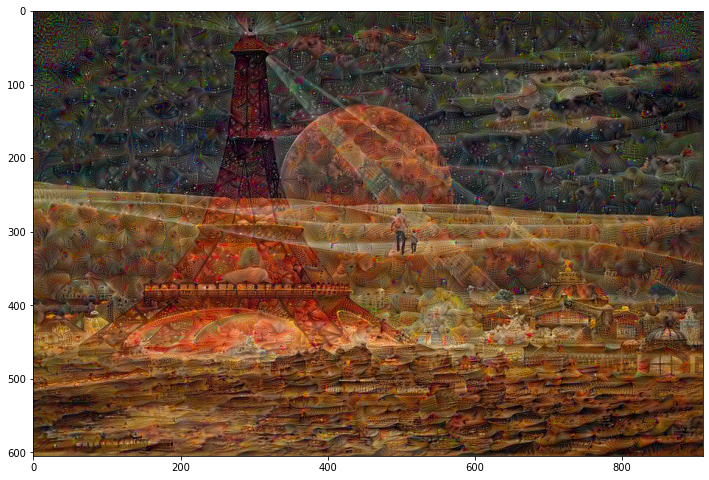

step 1200, loss2.180509328842163


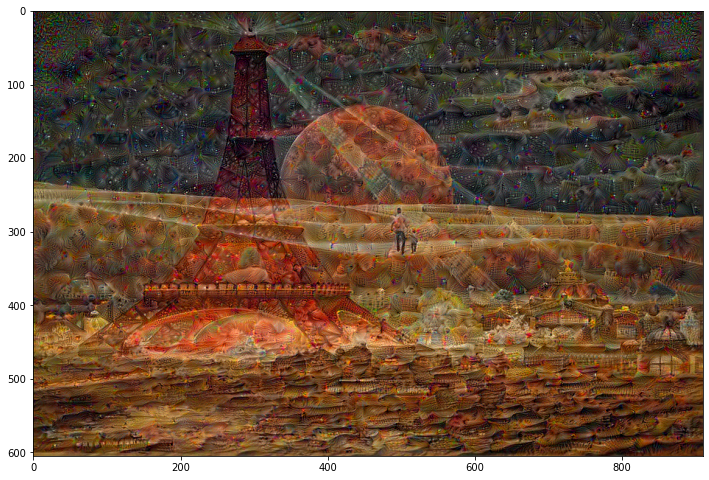

step 1300, loss2.2156388759613037


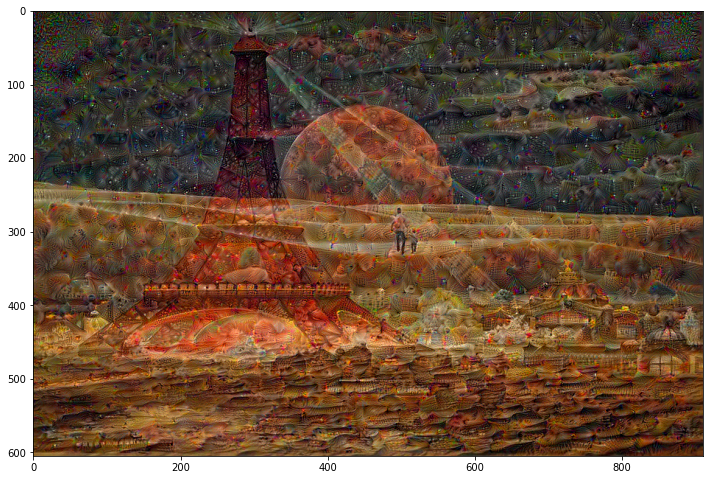

step 1400, loss2.2480711936950684


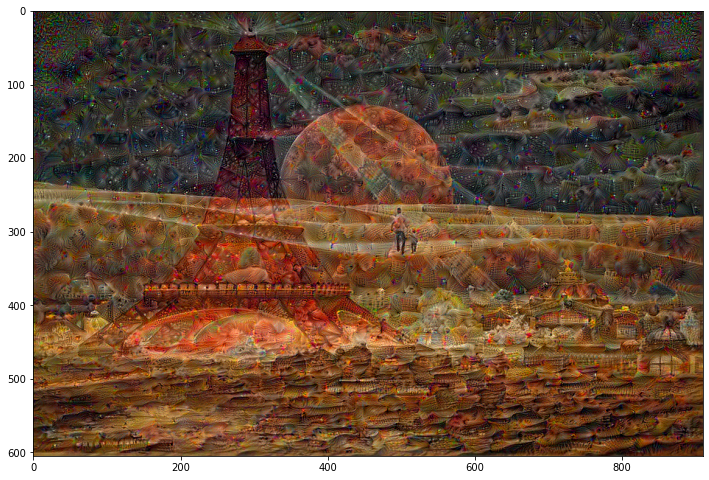

step 1500, loss2.278245449066162


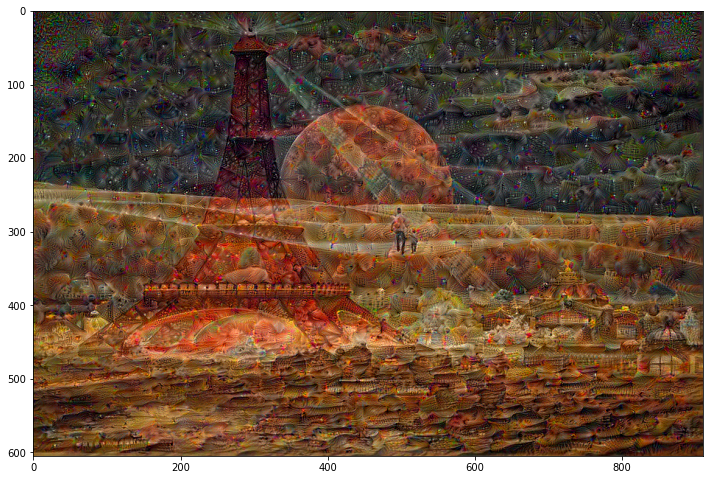

step 1600, loss2.306845188140869


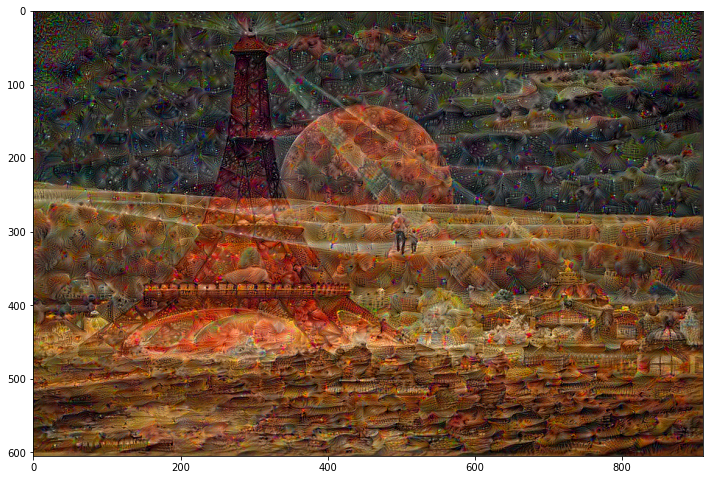

step 1700, loss2.333235025405884


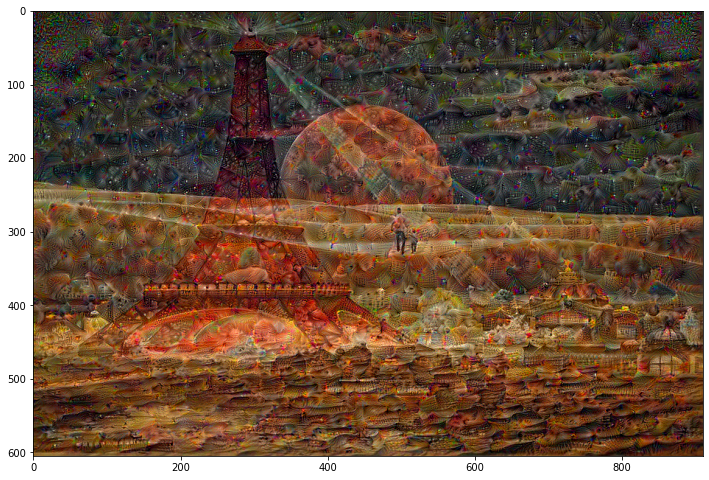

step 1800, loss2.3584372997283936


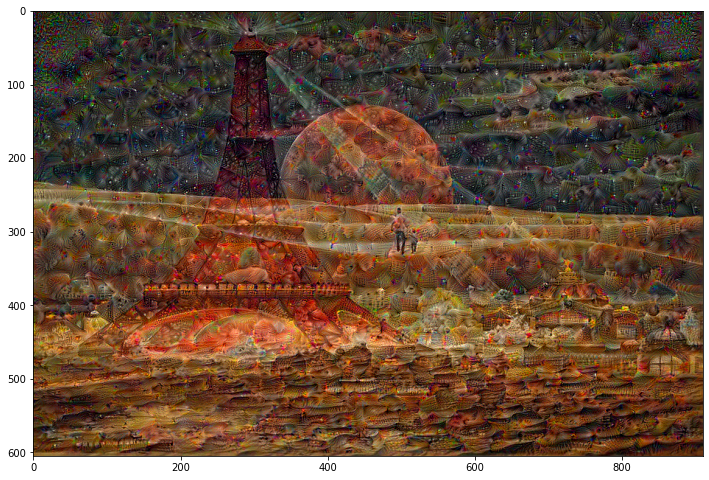

step 1900, loss2.382018566131592


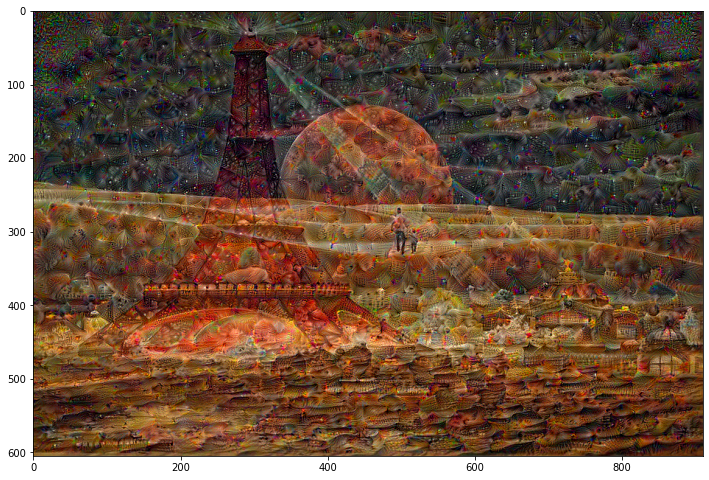

step 2000, loss2.404968500137329


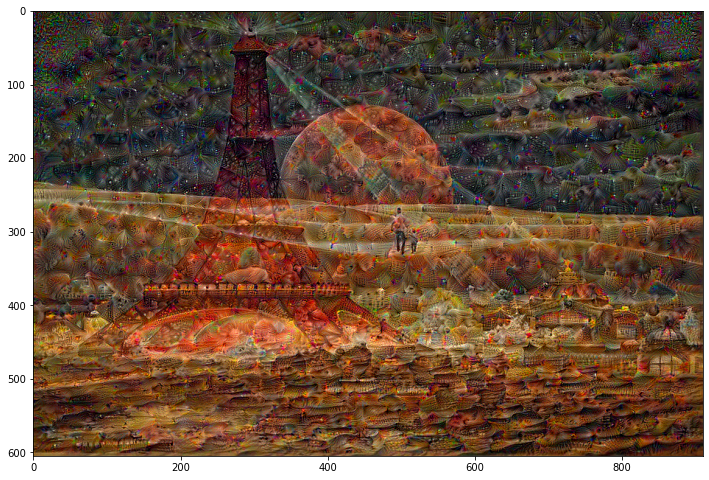

step 2100, loss2.4265341758728027


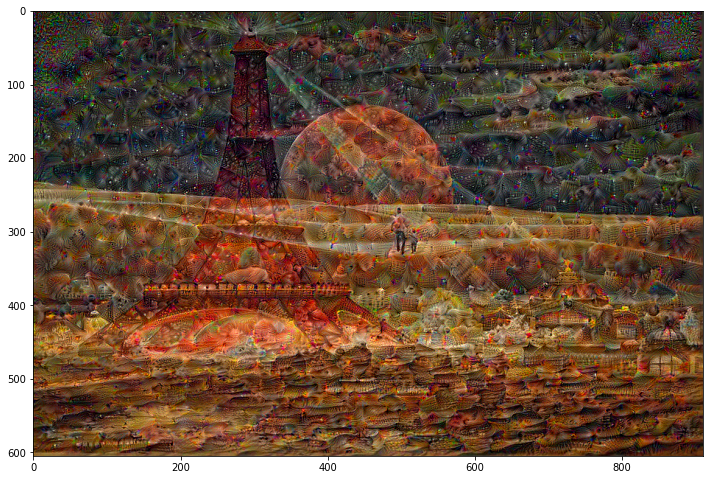

step 2200, loss2.4474105834960938


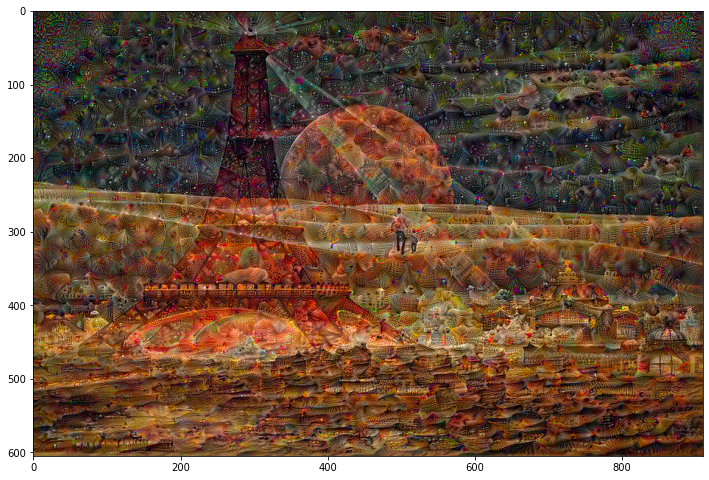

step 2300, loss2.4675087928771973


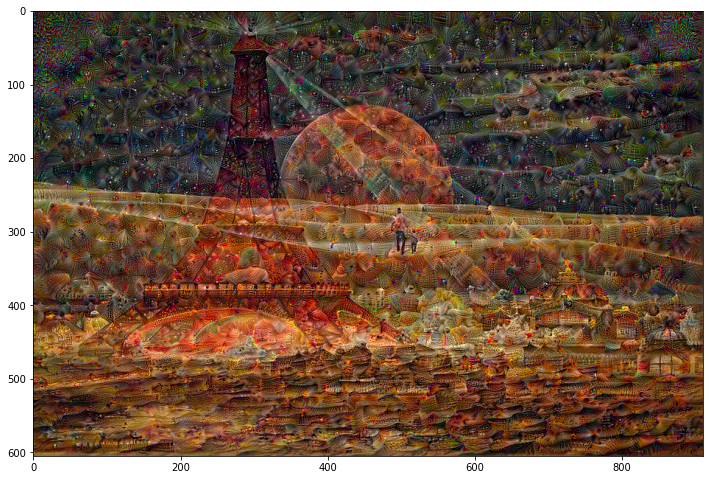

step 2400, loss2.4866979122161865


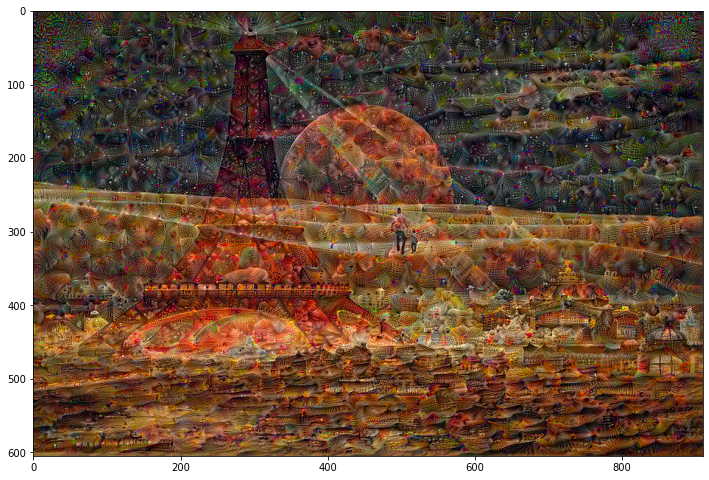

step 2500, loss2.5053508281707764


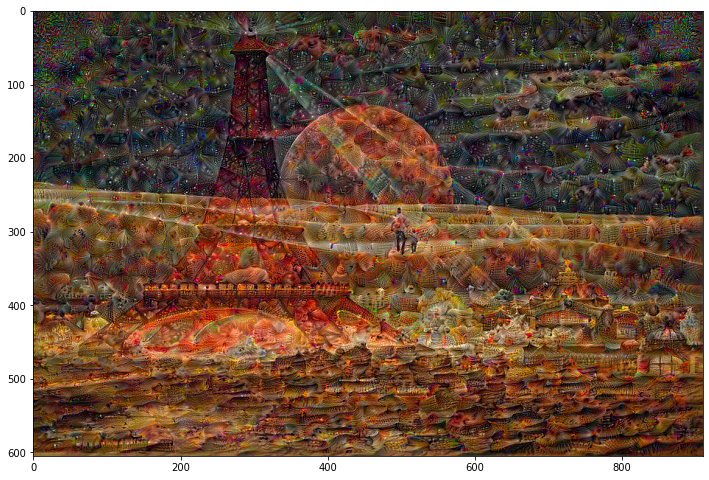

step 2600, loss2.5236992835998535


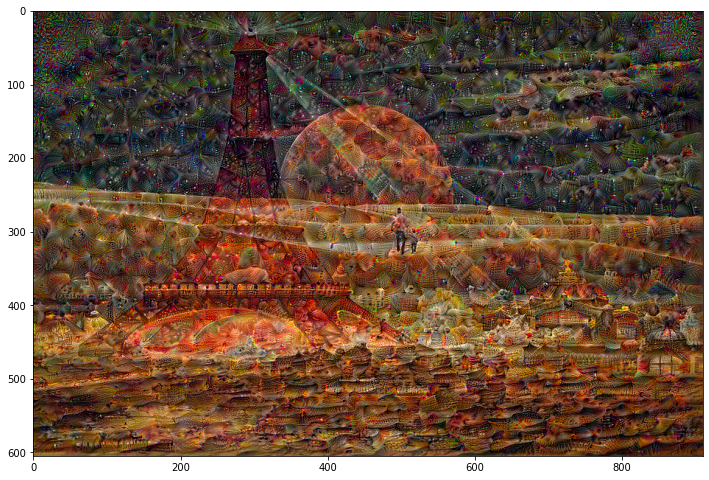

step 2700, loss2.5412464141845703


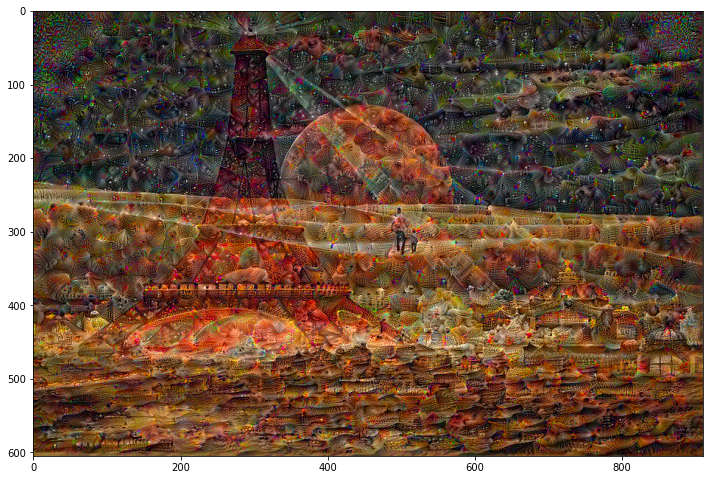

step 2800, loss2.558551788330078


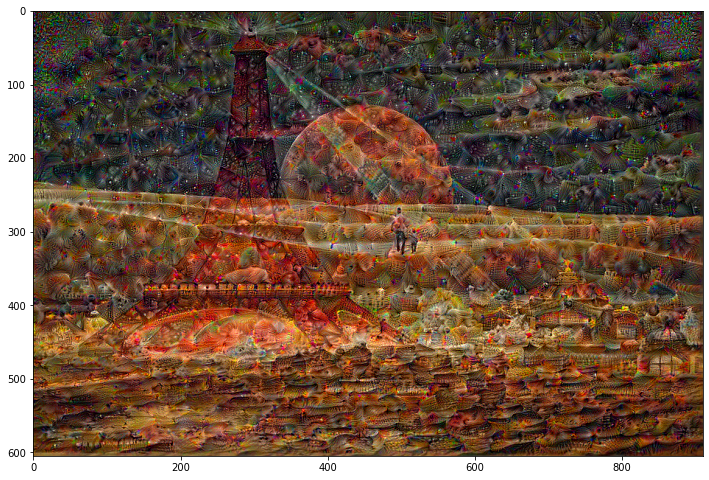

step 2900, loss2.575240135192871


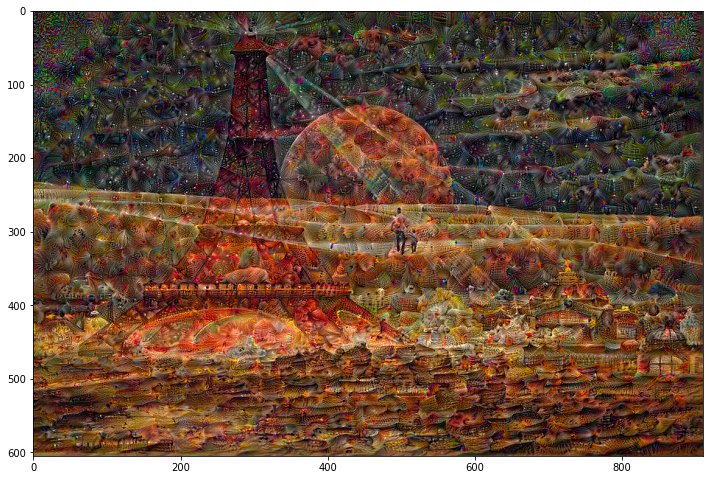

step 3000, loss2.591444492340088


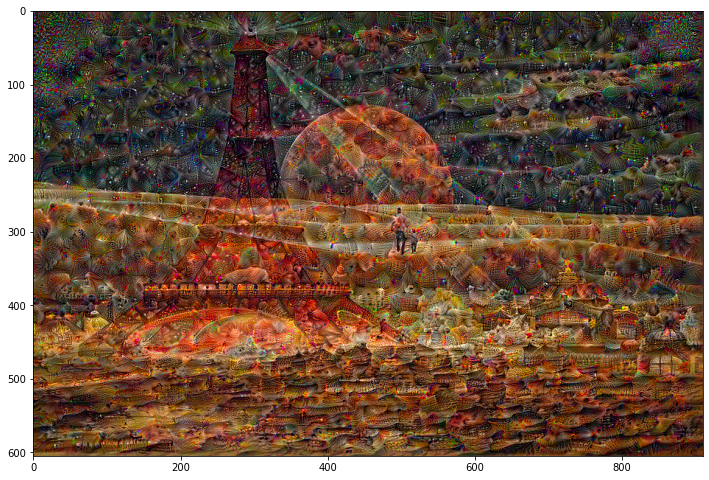

step 3100, loss2.6069982051849365


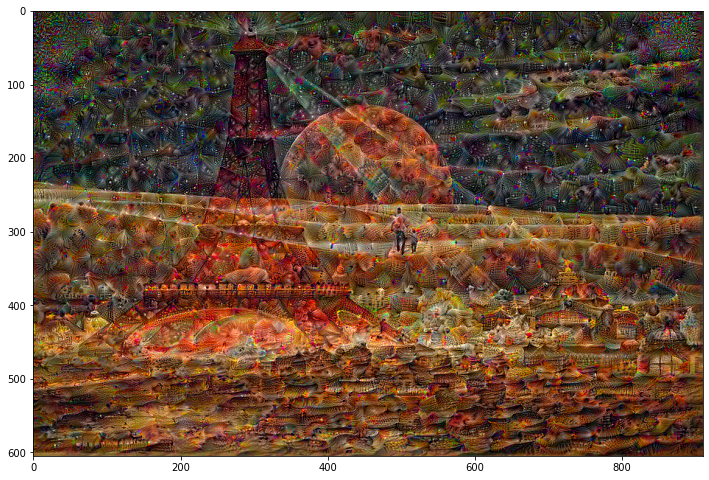

step 3200, loss2.622713088989258


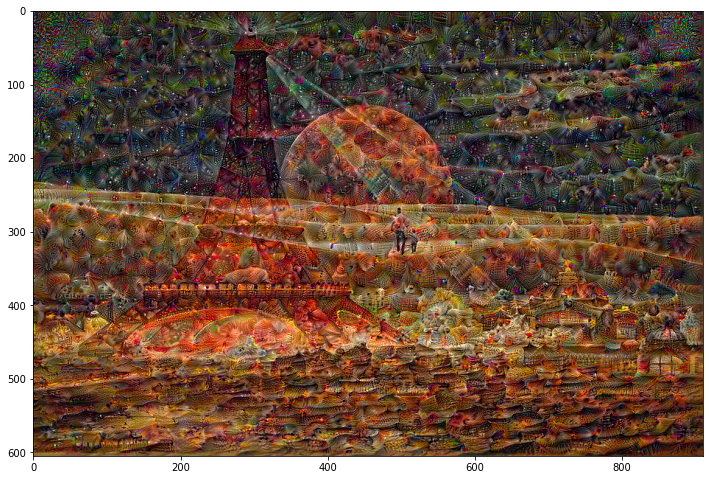

step 3300, loss2.637401580810547


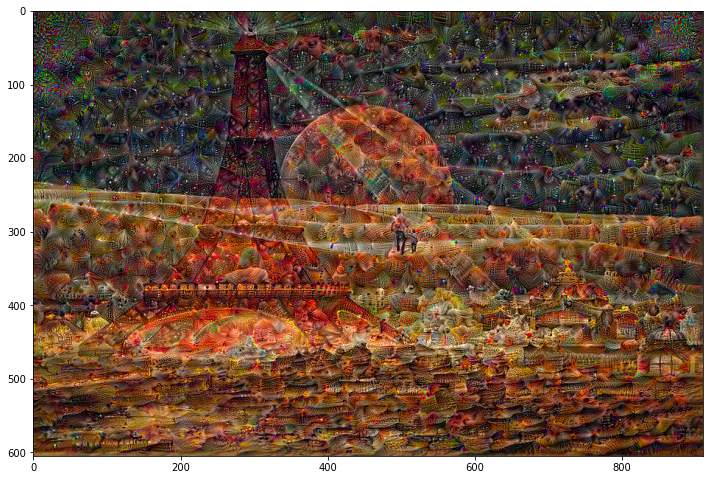

step 3400, loss2.652024507522583


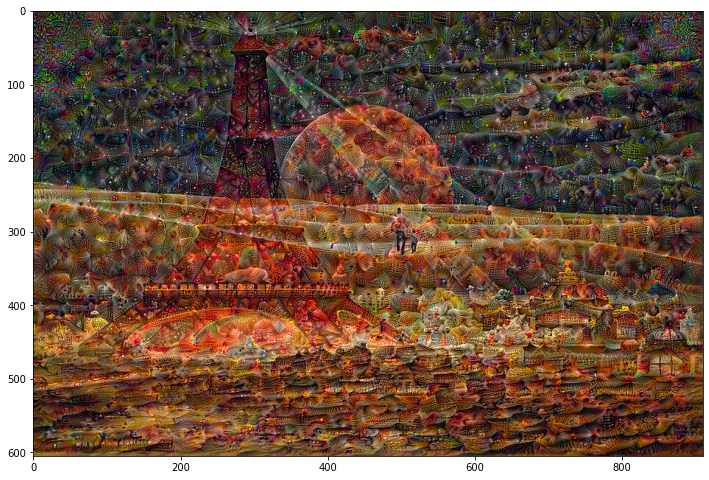

step 3500, loss2.666313648223877


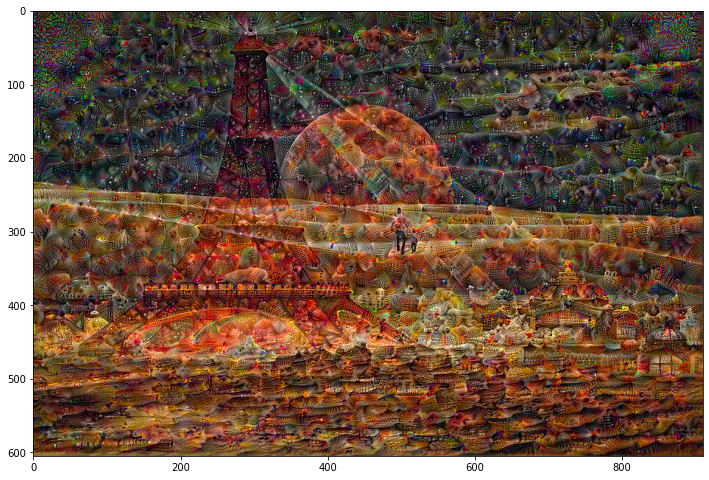

step 3600, loss2.680180072784424


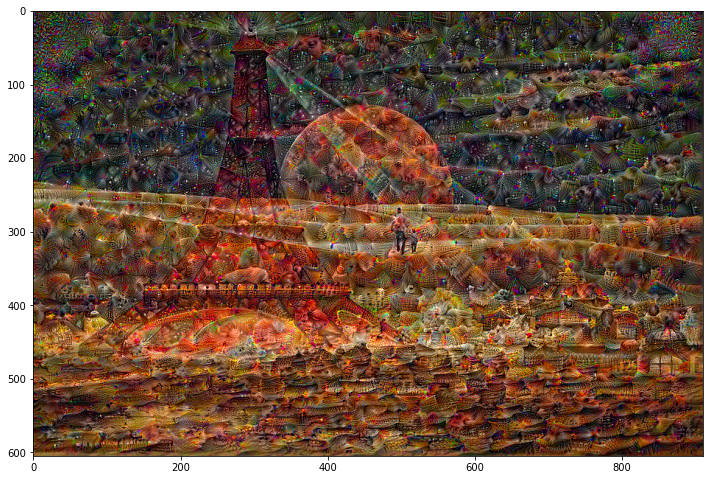

step 3700, loss2.6939311027526855


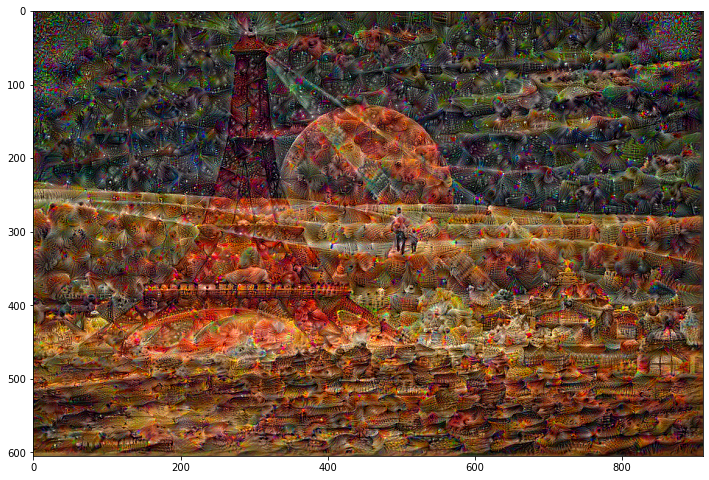

step 3800, loss2.707143783569336


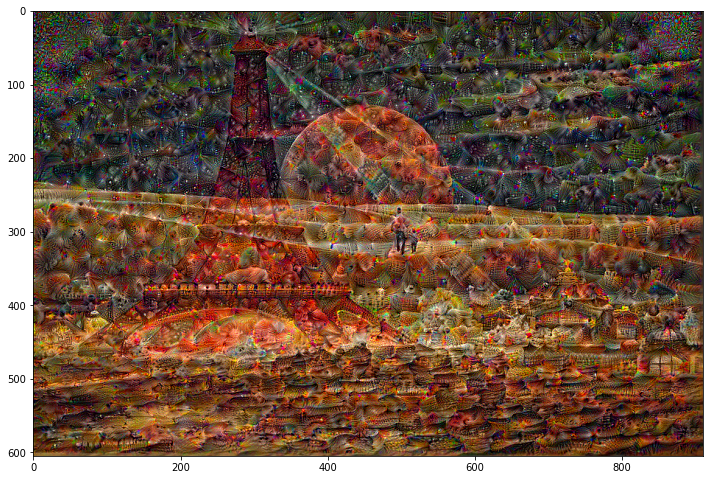

step 3900, loss2.72019362449646


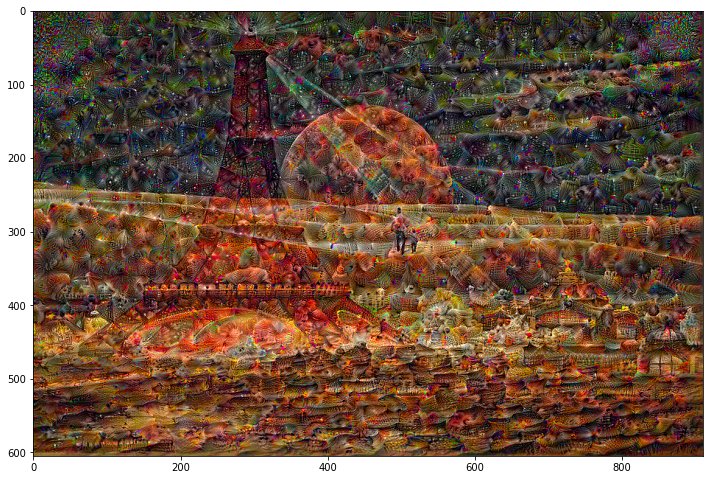

In [36]:
sample_image = np.array(tf.keras.preprocessing.image.load_img('img_0.jpg'))
dream_img = run_deep_dream_simple(model = deepdream_model, image = sample_image, steps = 4000, step_size= 0.001)

In [37]:
image = tf.keras.preprocessing.image.load_img("img_0.jpg")

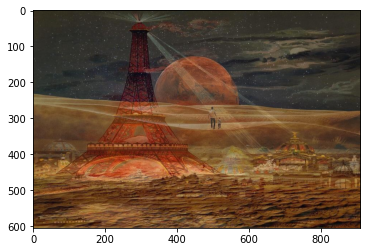

In [38]:
plt.imshow(image)

In [39]:
dream_name = "mars_eiffel"

In [40]:
x_size = 910
y_size = 605

In [41]:
created_count = 0
max_count = 50

In [42]:
def load_image(filename):
    image = PIL.Image.open(filename)
    return np.float32(image)

In [63]:
# Make sure to Create a new folder entitled "mars_eiffel" and place img_0 in it. 

for i in range(0, 50):
    if os.path.isfile('{}/img_{}.jpg'.format(dream_name, i+1)):
        print("{} Present already, continue fetching the frames.".format(i+1))
        
    else:
        img_result = load_image(r'{}/img_{}.jpg'.format(dream_name, i+1))
    
        x_zoom = 2
        y_zoom = 1
        
        img_result = img_result[0+x_zoom : y_size-y_zoom, 0+y_zoom : x_size-x_zoom]
        img_result = cv2.resize(img_result, (x_size, y_size))
        
        img_result[:, :, 0] +=2
        img_result[:, :, 1] +=2
        img_result[:, :, 2] +=2
        
        img_result = run_deep_dream_simple(model=deepdream_model, image = img_result, steps = 500, step_size=0.001)
        
        img_result = np.clip(img_result, 0.0, 255.0)
        img_result = img_result.astype(np.uint8)
        result = PIL.Image.fromarray(img_result, mode='RGB')
        
        result.save(r'{}/img_{}.jpg'.format(dream_name, i+1))
        
        
        created_count +=1
        if created_count > max_count:
            break

1 Present already, continue fetching the frames.
2 Present already, continue fetching the frames.
3 Present already, continue fetching the frames.
4 Present already, continue fetching the frames.
5 Present already, continue fetching the frames.
6 Present already, continue fetching the frames.
7 Present already, continue fetching the frames.
8 Present already, continue fetching the frames.
9 Present already, continue fetching the frames.
10 Present already, continue fetching the frames.
11 Present already, continue fetching the frames.
12 Present already, continue fetching the frames.
13 Present already, continue fetching the frames.
14 Present already, continue fetching the frames.
15 Present already, continue fetching the frames.
16 Present already, continue fetching the frames.
17 Present already, continue fetching the frames.
18 Present already, continue fetching the frames.
19 Present already, continue fetching the frames.
20 Present already, continue fetching the frames.
21 Presen

In [66]:
dream_path = 'mars_eiffel'

In [67]:
fourcc = cv2.VideoWriter_fourcc(*'XVID')

out = cv2.VideoWriter('deepdreamvideo.avi', fourcc, 5.0, (910, 605))

In [69]:
for i in range(9999999999999):
    if os.path.isfile('mars_eiffel/img_{}.jpg'.format(i+1)):
        pass
    else:
        dream_length = i
        break

In [70]:
dream_length

200

In [71]:
for i in range(dream_length):
    img_path = os.path.join(dream_path,'img_{}.jpg'.format(i))
    print(img_path)
    frame = cv2.imread(img_path)
    out.write(frame)

out.release()

mars_eiffel\img_0.jpg
mars_eiffel\img_1.jpg
mars_eiffel\img_2.jpg
mars_eiffel\img_3.jpg
mars_eiffel\img_4.jpg
mars_eiffel\img_5.jpg
mars_eiffel\img_6.jpg
mars_eiffel\img_7.jpg
mars_eiffel\img_8.jpg
mars_eiffel\img_9.jpg
mars_eiffel\img_10.jpg
mars_eiffel\img_11.jpg
mars_eiffel\img_12.jpg
mars_eiffel\img_13.jpg
mars_eiffel\img_14.jpg
mars_eiffel\img_15.jpg
mars_eiffel\img_16.jpg
mars_eiffel\img_17.jpg
mars_eiffel\img_18.jpg
mars_eiffel\img_19.jpg
mars_eiffel\img_20.jpg
mars_eiffel\img_21.jpg
mars_eiffel\img_22.jpg
mars_eiffel\img_23.jpg
mars_eiffel\img_24.jpg
mars_eiffel\img_25.jpg
mars_eiffel\img_26.jpg
mars_eiffel\img_27.jpg
mars_eiffel\img_28.jpg
mars_eiffel\img_29.jpg
mars_eiffel\img_30.jpg
mars_eiffel\img_31.jpg
mars_eiffel\img_32.jpg
mars_eiffel\img_33.jpg
mars_eiffel\img_34.jpg
mars_eiffel\img_35.jpg
mars_eiffel\img_36.jpg
mars_eiffel\img_37.jpg
mars_eiffel\img_38.jpg
mars_eiffel\img_39.jpg
mars_eiffel\img_40.jpg
mars_eiffel\img_41.jpg
mars_eiffel\img_42.jpg
mars_eiffel\img_43.jp